# Package

In [25]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from statsmodels.tsa.ar_model import AutoReg  
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
import seaborn as sns
from scipy.stats import norm
from scipy.stats import shapiro
from statsmodels.stats.stattools import jarque_bera
import statsmodels.api as sm
from statsmodels.tsa.stattools import adfuller
from statsmodels.stats.diagnostic import het_arch
import matplotlib.pyplot as plt
from statsmodels.graphics.tsaplots import plot_acf
from arch import arch_model
from statsmodels.stats.diagnostic import het_arch, acorr_ljungbox
from sklearn.metrics import mean_squared_error
from statsmodels.tsa.ar_model import AutoReg

# Importation des données

In [12]:
# Lire le fichier brut
with open("lbl-tcp-3.tcp", "r", encoding="latin-1") as f:
    lignes = f.readlines()

# Afficher quelques lignes pour voir la structure
for i, ligne in enumerate(lignes[:20]):  # juste les 20 premières
    print(i, ligne.strip())

0 759103800.008185 1 2 23 2436 1
1 0.010445 2 1 2436 23 2
2 0.023775 1 2 23 2436 2
3 0.026558 2 1 2436 23 1
4 0.029002 3 4 3930 119 42
5 0.032439 4 3 119 3930 15
6 0.049618 1 2 23 2436 1
7 0.052431 5 2 14037 23 2
8 0.056457 2 5 23 14037 2
9 0.057815 6 7 23 1502 414
10 0.072126 8 9 1023 513 0
11 0.098415 3 4 3930 119 55
12 0.104465 4 3 119 3930 15
13 0.122345 10 11 6000 2290 0
14 0.124490 7 6 1502 23 0
15 0.125228 2 1 2436 23 1
16 0.138935 1 2 23 2436 1
17 0.139950 12 13 1208 6000 64
18 0.140930 2 1 2436 23 1
19 0.146912 13 12 6000 1208 32


In [13]:
# Chargement brut : 6 colonnes, séparateur = espaces ----
path = "lbl-tcp-3.tcp"

colnames = ["ts", "src_id", "dst_id", "src_port", "dst_port", "val"]
df = pd.read_csv(
    path,
    sep=r"\s+",            # espaces multiples
    header=None,
    names=colnames,
    engine="python",
    dtype={
        "ts": float,
        "src_id": np.int64,
        "dst_id": np.int64,
        "src_port": np.int64,
        "dst_port": np.int64,
        "val": np.int64
    }
)

In [14]:
df.head()

,ts,src_id,dst_id,src_port,dst_port,val
0,7.591038e+08,1,2,23,2436,1
1,1.044500e-02,2,1,2436,23,2
2,2.377500e-02,1,2,23,2436,2
3,2.655800e-02,2,1,2436,23,1
4,2.900200e-02,3,4,3930,119,42


In [15]:
df["val"].describe()

count    1.789995e+06
mean     1.363555e+02
std      2.388757e+02
min     -4.000000e+00
25%      0.000000e+00
50%      4.000000e+00
75%      1.250000e+02
max      1.460000e+03
Name: val, dtype: float64

In [16]:
# On doit donc analyser par paquet
# 1) Point de départ
t0 = df['ts'].min()

# 2) Intervalles de 10 s (fenêtres [0,10), [10,20), …, [7190,7200))
df['Interval'] = np.floor((df['ts'] - t0 - 1e-9) / 10).astype(int)

# 3) Garder seulement 720 intervalles (0..719)
df = df[df['Interval'].between(0, 719)]

In [17]:
# On doit donc analyser par paquet
# 1) Point de départ
t0 = df['ts'].min()

# 2) Intervalles de 10 s (fenêtres [0,10), [10,20), …, [7190,7200))
df['Interval'] = np.floor((df['ts'] - t0 - 1e-9) / 10).astype(int)

# 3) Garder seulement 720 intervalles (0..719)
df = df[df['Interval'].between(0, 719)]

In [19]:
# Série de longueur 720 : nombre de lignes par fenêtre de 10 s
ts_series = (
    df.groupby('Interval')
      .size()
      .reindex(range(720), fill_value=0)  # assure les fenêtres vides
)

# Index en temps relatif (0s, 10s, 20s, …)
ts_series.index = pd.to_timedelta(ts_series.index * 10, unit='s')
ts_series.name = 'count'

In [20]:
ts_series

Interval
0 days 00:00:00    1618
0 days 00:00:10    1723
0 days 00:00:20    3226
0 days 00:00:30    1762
0 days 00:00:40    1895
                   ... 
0 days 01:59:10    3163
0 days 01:59:20    2647
0 days 01:59:30    2632
0 days 01:59:40    2169
0 days 01:59:50    2817
Name: count, Length: 720, dtype: int64

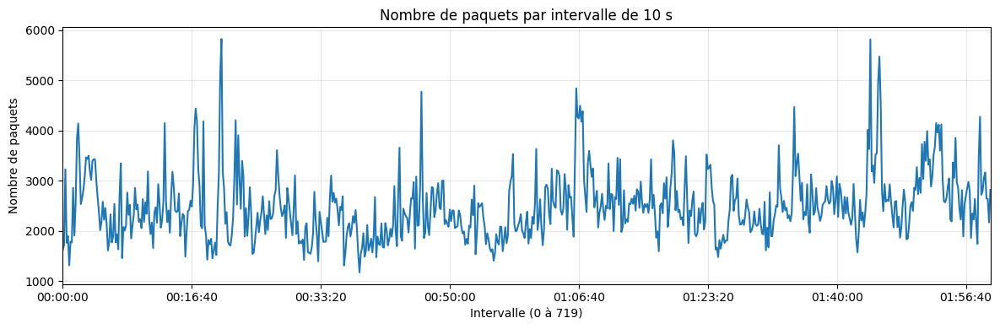

In [57]:
plt.figure(figsize=(12,4))
ts_series.plot()
plt.title("Nombre de paquets par intervalle de 10 s")
plt.xlabel("Intervalle (0 à 719)")
plt.ylabel("Nombre de paquets")
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

In [58]:
ts_series.mean()

np.float64(2486.1)

Le traffic n'augmente pas dans le temps et on observe pas une certaine saisonnalité. Intuitivement, il est stationnaire. Par contre, on s'apercôit une grande volatilité.

# 2. Analyse de la stationnarité et de la volatilité

## 2.1. Analyse de la stationnarité

In [28]:
result = adfuller(ts_series)

print("Statistique ADF:", result[0])
print("p-value:", result[1])
print("Valeurs critiques:", result[4])
if result[1] < 0.05:
    print("✅ On rejette H0 : la série est stationnaire.")
else:
    print("❌ On ne rejette pas H0 : la série est non-stationnaire.")

Statistique ADF: -8.273733022326098
p-value: 4.717307069120435e-13
Valeurs critiques: {'1%': np.float64(-3.439516060164992), '5%': np.float64(-2.8655850998755263), '10%': np.float64(-2.5689240826597173)}
✅ On rejette H0 : la série est stationnaire.


## 2.2. Analyse de la série au carré

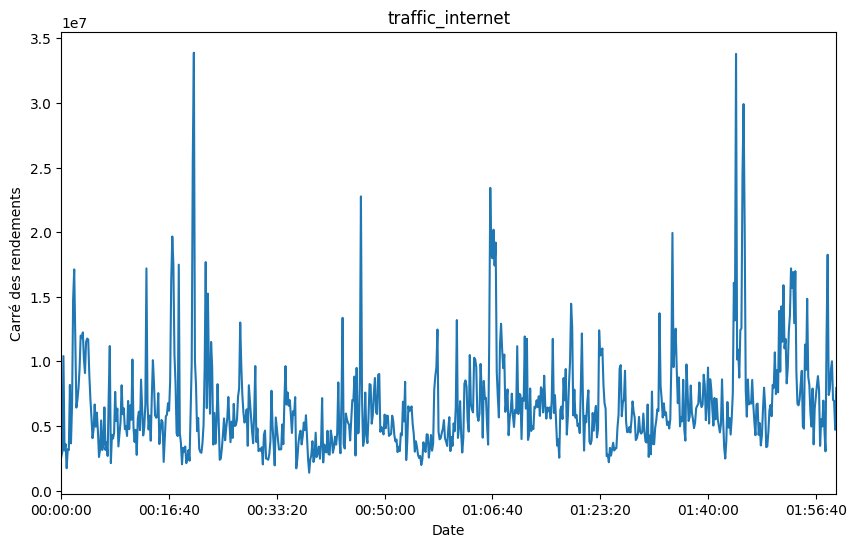

In [23]:
ts_series_squared = ts_series ** 2
ts_series_squared.plot(figsize=(10, 6))
plt.title("traffic_internet")
plt.xlabel("Date")
plt.ylabel("Carré des rendements")
plt.show()

Elevé au carré, le traffic nous montre clairement la présence d'une volatilité forte avec des pics présents partout. 

# 3. Analyse de l'autocorrélation

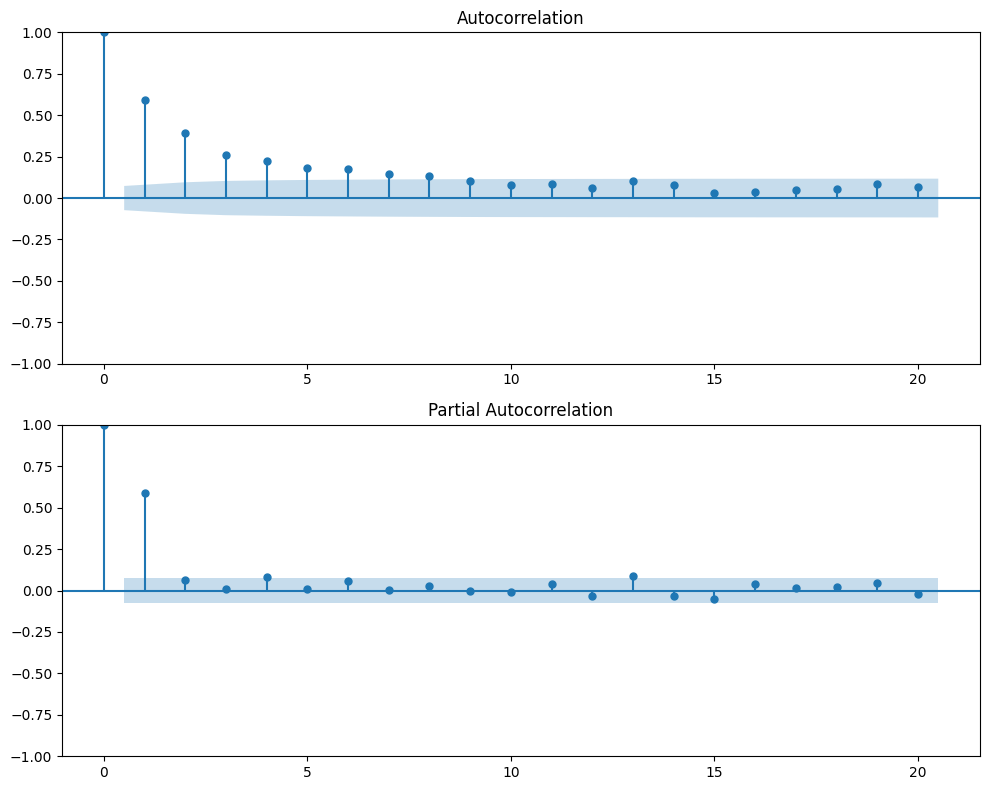

In [26]:
fig, ax = plt.subplots(nrows=2, figsize=(10, 8))
plot_acf(ts_series_squared, ax=ax[0], lags=20, alpha=0.05)
plot_pacf(ts_series_squared, ax=ax[1], lags=20, alpha=0.05)

plt.tight_layout()
plt.show()

Nous voyons clairement qu'il y a une dépendance temporelle existente dans la série au carré.

Ainsi, nous allons optimisé un modèle GARCH

# 4. Optimiser GARCH

In [29]:
# ============================================
# Étape 1 — Préparation des données
# ============================================
y = pd.Series(ts_series, dtype=float).dropna()
n = len(y)
h = int(0.1 * n)                 # 20% pour le test
y_train, y_test = y.iloc[:-h], y.iloc[-h:]
idx_train, idx_test = y_train.index, y_test.index
pmax = min(20, max(5, n // 10))  # borne prudente (modifiable)
K = 5                             # nb de splits pour backtesting

In [32]:
from arch import arch_model

ic_rows = []
pmax, qmax = 5, 5  # bornes des ordres GARCH

for p in range(1, pmax+1):
    for q in range(1, qmax+1):
        try:
            model = arch_model(y_train, vol="GARCH", p=p, q=q, mean="AR", lags=1, dist="normal")
            res = model.fit(disp="off")
            ic_rows.append({"p": p, "q": q, "AIC": res.aic, "BIC": res.bic})
        except Exception:
            ic_rows.append({"p": p, "q": q, "AIC": np.nan, "BIC": np.nan})

ic_df = pd.DataFrame(ic_rows)

d:\Portofolio Data science\Time Series\Travaux pratiques Bases\.venv\Lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 2.653e+05. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 0.1 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
d:\Portofolio Data science\Time Series\Travaux pratiques Bases\.venv\Lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 2.653e+05. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 0.1 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  war

In [33]:
ic_df.head()

,p,q,AIC,BIC
0,1,1,9853.923114,9876.284846
1,1,2,9855.923098,9882.757176
2,1,3,9856.425508,9887.731932
3,1,4,9853.856063,9889.634834
4,1,5,9848.621371,9888.872488


In [34]:
from arch import arch_model
import numpy as np
import pandas as pd

def ts_cv_rmse_garch(series: pd.Series, p: int, q: int, nchunks: int = 5):
    s = pd.Series(series).dropna()
    n = len(s)
    cuts = np.linspace(0, n, nchunks + 1, dtype=int)
    rmses = []
    
    for k in range(nchunks - 1):
        train = s.iloc[:cuts[k+1]]
        validation = s.iloc[cuts[k+1]:cuts[k+2]]
        if len(train) < max(p, q) + 1 or len(validation) == 0:
            continue
        
        try:
            # Modèle GARCH avec moyenne AR(1) (modifiable selon ton cas)
            model = arch_model(train, vol="GARCH", p=p, q=q, mean="AR", lags=1, dist="normal")
            res = model.fit(disp="off")
            
            # Prévision de la moyenne conditionnelle
            forecasts = res.forecast(horizon=len(validation))
            pred = forecasts.mean.iloc[-1].values
            pred_series = pd.Series(pred, index=validation.index)
            
            # Calcul du RMSE
            rmse = np.sqrt(((validation - pred_series)**2).mean())
            rmses.append(rmse)
        except Exception:
            rmses.append(np.nan)
    
    return float(np.nanmean(rmses)) if rmses else np.nan


# Exemple : grille de modèles GARCH(p,q)
pmax, qmax, K = 3, 3, 5  # p, q jusqu’à 3 et 5 splits
cv_rows = []

for p in range(1, pmax+1):
    for q in range(1, qmax+1):
        cv_rmse = ts_cv_rmse_garch(y_train, p, q, nchunks=K)
        cv_rows.append({"p": p, "q": q, "CV_RMSE": cv_rmse})

cv_df = pd.DataFrame(cv_rows)
print(cv_df.sort_values("CV_RMSE"))


d:\Portofolio Data science\Time Series\Travaux pratiques Bases\.venv\Lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 3.746e+05. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 0.1 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
d:\Portofolio Data science\Time Series\Travaux pratiques Bases\.venv\Lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 2.889e+05. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 0.1 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  war

   p  q     CV_RMSE
7  3  2  631.681357
0  1  1  631.810715
3  2  1  631.812566
6  3  1  631.813342
8  3  3  631.968560
4  2  2  632.156232
1  1  2  632.188905
5  2  3  632.439506
2  1  3  632.804504


d:\Portofolio Data science\Time Series\Travaux pratiques Bases\.venv\Lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 2.685e+05. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 0.1 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
d:\Portofolio Data science\Time Series\Travaux pratiques Bases\.venv\Lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 2.62e+05. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 0.1 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warn

In [36]:
# Fusion sur p et q (pas seulement sur p)
out = ic_df.merge(cv_df, on=["p", "q"]).sort_values(["p","q"]).reset_index(drop=True)

print("Table des scores (p, q, AIC, BIC, CV_RMSE):")
print(out)

# Meilleurs couples (p,q) selon chaque critère
best_aic = out.loc[out["AIC"].idxmin(), ["p", "q"]]
best_bic = out.loc[out["BIC"].idxmin(), ["p", "q"]]
best_cv  = out.loc[out["CV_RMSE"].idxmin(), ["p", "q"]]

print("\nChoix de (p,q) :")
print(f"  AIC  → GARCH({best_aic['p']}, {best_aic['q']})")
print(f"  BIC  → GARCH({best_bic['p']}, {best_bic['q']})")
print(f"  CV   → GARCH({best_cv['p']}, {best_cv['q']})   (prévision)")

Table des scores (p, q, AIC, BIC, CV_RMSE):
   p  q          AIC          BIC     CV_RMSE
0  1  1  9853.923114  9876.284846  631.810715
1  1  2  9855.923098  9882.757176  632.188905
2  1  3  9856.425508  9887.731932  632.804504
3  2  1  9853.348830  9880.182908  631.812566
4  2  2  9855.345226  9886.651650  632.156232
5  2  3  9858.425531  9894.204302  632.439506
6  3  1  9855.348815  9886.655239  631.813342
7  3  2  9857.345233  9893.124003  631.681357
8  3  3  9860.425514  9900.676631  631.968560

Choix de (p,q) :
  AIC  → GARCH(2.0, 1.0)
  BIC  → GARCH(1.0, 1.0)
  CV   → GARCH(3.0, 2.0)   (prévision)


# 5. Réentrainement de GARCH (3,2)

In [83]:
best_model = arch_model(y_train, mean = "Zero", vol="GARCH", p=3, q=2, dist="normal")
best_res = best_model.fit(disp="off")
print(best_res.summary())

                       Zero Mean - GARCH Model Results                        
Dep. Variable:                  count   R-squared:                       0.000
Mean Model:                 Zero Mean   Adj. R-squared:                  0.002
Vol Model:                      GARCH   Log-Likelihood:               -5980.23
Distribution:                  Normal   AIC:                           11972.5
Method:            Maximum Likelihood   BIC:                           11999.3
                                        No. Observations:                  648
Date:                Wed, Sep 03 2025   Df Residuals:                      648
Time:                        15:54:52   Df Model:                            0
                               Volatility Model                              
                 coef    std err          t      P>|t|       95.0% Conf. Int.
-----------------------------------------------------------------------------
omega      1.9170e+06  9.367e+06      0.205      0.838 

d:\Portofolio Data science\Time Series\Travaux pratiques Bases\.venv\Lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 4.133e+05. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 0.1 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(


Notre analyse montre que :
- GARCH(3,2) est le meilleur choix pour prévoir la série.
- La dynamique de la volatilité est surtout expliquée par l’effet immédiat des chocs (ARCH), alors que les composantes GARCH de mémoire longue sont faibles.

# 6. Analyse des résidus

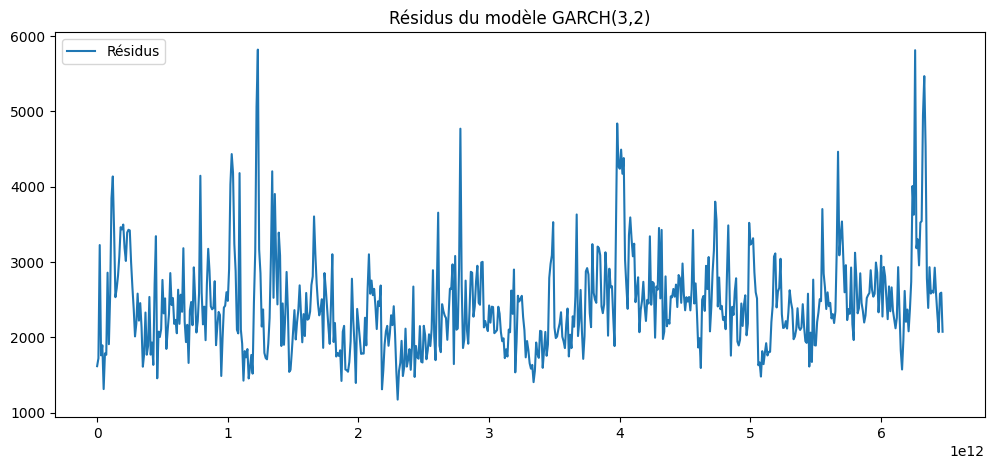

In [84]:
import matplotlib.pyplot as plt

# Résidus bruts
resid = best_res.resid

plt.figure(figsize=(12,5))
plt.plot(resid, label="Résidus")
plt.title("Résidus du modèle GARCH(3,2)")
plt.legend()
plt.show()

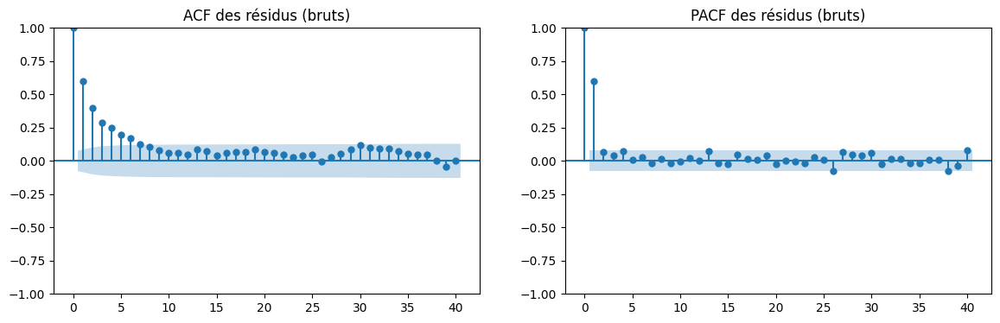

In [85]:
fig, axes = plt.subplots(1, 2, figsize=(14,4))
plot_acf(resid, lags=40, ax=axes[0])
axes[0].set_title("ACF des résidus (bruts)")
plot_pacf(resid, lags=40, ax=axes[1])
axes[1].set_title("PACF des résidus (bruts)")
plt.show()


In [86]:
from statsmodels.stats.diagnostic import acorr_ljungbox

# Ljung-Box test sur résidus
lb_test_resid = acorr_ljungbox(resid, lags=[i for i in range(1, 13)], return_df=True)
print("Ljung-Box Test sur résidus:\n", lb_test_resid)

# Ljung-Box test sur carrés des résidus
lb_test_resid_sq = acorr_ljungbox(resid**2, lags=[i for i in range(1, 13)], return_df=True)
print("\nLjung-Box Test sur carrés des résidus:\n", lb_test_resid_sq)

Ljung-Box Test sur résidus:
        lb_stat      lb_pvalue
1   231.948832   2.240487e-52
2   335.425428   1.456444e-73
3   389.766430   3.645419e-84
4   429.816904   1.001647e-91
5   455.623475   3.007488e-96
6   474.630792   2.446329e-99
7   485.042540  1.315620e-100
8   492.622044  2.692048e-101
9   496.529510  3.181899e-101
10  498.818028  7.897177e-101
11  501.037104  1.927250e-100
12  502.690004  5.930805e-100

Ljung-Box Test sur carrés des résidus:
        lb_stat     lb_pvalue
1   218.083045  2.368800e-49
2   304.534254  7.434075e-67
3   339.749150  2.472870e-73
4   363.509595  2.122087e-77
5   378.300272  1.406543e-79
6   393.371908  7.435467e-82
7   403.455547  4.329799e-83
8   410.386520  1.123059e-83
9   412.985194  2.319070e-83
10  413.961037  1.003328e-82
11  415.291433  3.460798e-82
12  415.986536  1.553288e-81


# Observer la précision de l'estimation de la prévisibilité

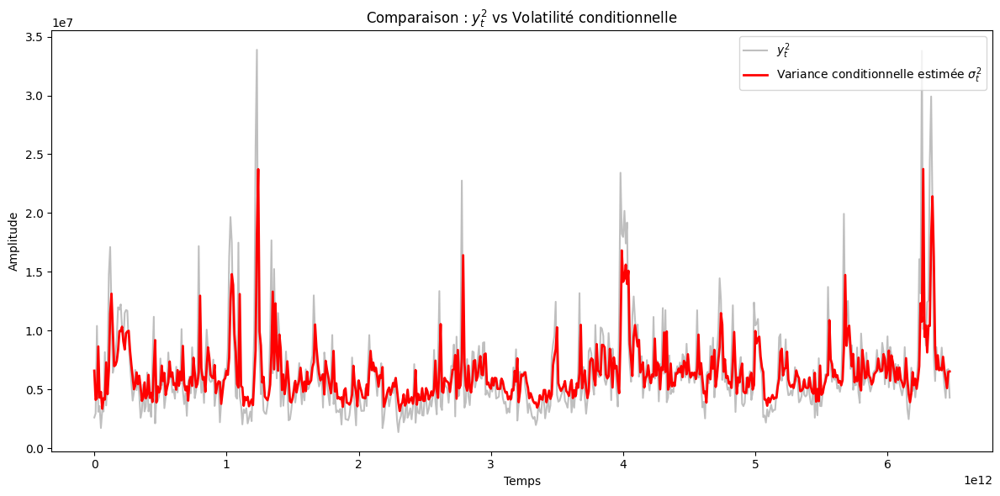

In [87]:
import matplotlib.pyplot as plt

# Variance conditionnelle estimée par le modèle ARCH/GARCH
sigma2_t = best_res.conditional_volatility ** 2  

# y au carré
y_sq = y_train ** 2

# ================================
# Graphique : σ_t² vs y²
# ================================
plt.figure(figsize=(12,6))
plt.plot(y_sq, color="grey", alpha=0.5, label=r"$y_t^2$")
plt.plot(sigma2_t, color="red", linewidth=2, 
         label=r"Variance conditionnelle estimée $\sigma_t^2$")

plt.title("Comparaison : $y_t^2$ vs Volatilité conditionnelle")
plt.xlabel("Temps")
plt.ylabel("Amplitude")
plt.legend(loc="upper right")
plt.tight_layout()
plt.show()

<>:33: SyntaxWarning: invalid escape sequence '\h'
<>:33: SyntaxWarning: invalid escape sequence '\h'
C:\Users\Mita\AppData\Local\Temp\ipykernel_16948\1755903247.py:33: SyntaxWarning: invalid escape sequence '\h'
  plt.title("Prévision glissante sur la période test : $y_t^2$ vs $\hat{\sigma}_t^2$")
d:\Portofolio Data science\Time Series\Travaux pratiques Bases\.venv\Lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 4.133e+05. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 0.1 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
d:\Portofolio Data science\Time Series\Travaux pratiques Bases\.venv\Lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the opti

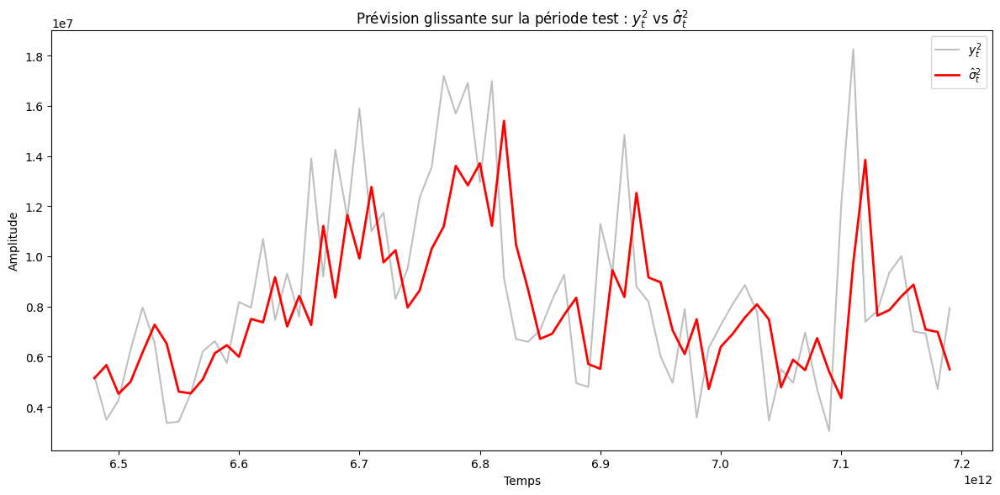

In [92]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from arch import arch_model

# Hypothèse : ts_series contient toute la série (train + test) avec un index temporel
test_size = len(y_test)   # taille du jeu de test
n_train = len(y_train)    # taille du jeu de train

rolling_sigma2 = []

for i in range(test_size):
    # Fenêtre expansive : train + i obs du test déjà connues
    train_i = ts_series.iloc[:n_train + i]

    am = arch_model(train_i, mean="Zero", vol="GARCH", p=3, q=2, dist="normal")
    res = am.fit(disp="off", update_freq=0)

    # Prévision 1-step-ahead pour la période suivante
    fcast = res.forecast(horizon=1, reindex=False)
    sigma2_next = fcast.variance.values[-1, 0]   # variance conditionnelle prédite
    rolling_sigma2.append(sigma2_next)

# Séries sur la période test
sigma2_test = pd.Series(rolling_sigma2, index=y_test.index)  # \hat{\sigma}_t^2
y_sq_test = y_test ** 2                                     # y_t^2

# -------- Graphique (test uniquement, un seul axe Y) --------
plt.figure(figsize=(12,6))
plt.plot(y_sq_test, color="grey", alpha=0.5, label=r"$y_t^2$")
plt.plot(sigma2_test, color="red", linewidth=2, label=r"$\hat{\sigma}_t^2$")

plt.title("Prévision glissante sur la période test : $y_t^2$ vs $\hat{\sigma}_t^2$")
plt.xlabel("Temps")
plt.ylabel("Amplitude")
plt.legend(loc="upper right")
plt.tight_layout()
plt.show()

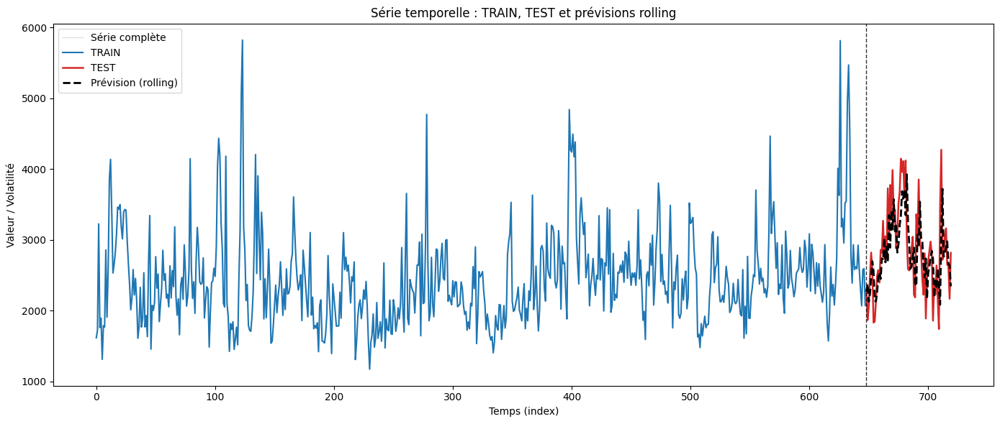

In [95]:
split_pos = len(y_train) - 0.5  # position de la coupure train/test

plt.figure(figsize=(14,6))

# Série complète en gris clair
plt.plot(ts_series.values, color="lightgrey", linewidth=1, alpha=0.7, label="Série complète")

# Train en bleu
plt.plot(range(len(y_train)), y_train.values, color="tab:blue", linewidth=1.5, label="TRAIN")

# Test en rouge
plt.plot(range(len(y_train), len(ts_series)), y_test.values, color="tab:red", linewidth=1.8, label="TEST")

# Prévisions rolling (par ex. variance conditionnelle prédite)
plt.plot(range(len(y_train), len(ts_series)), np.sqrt(rolling_sigma2), 
         color="black", linewidth=2, linestyle="--", label="Prévision (rolling)")

# Ligne de séparation
plt.axvline(split_pos, linestyle="--", linewidth=1, color="black", alpha=0.8)

plt.title("Série temporelle : TRAIN, TEST et prévisions rolling")
plt.xlabel("Temps (index)")
plt.ylabel("Valeur / Volatilité")
plt.legend(loc="upper left")
plt.tight_layout()
plt.show()

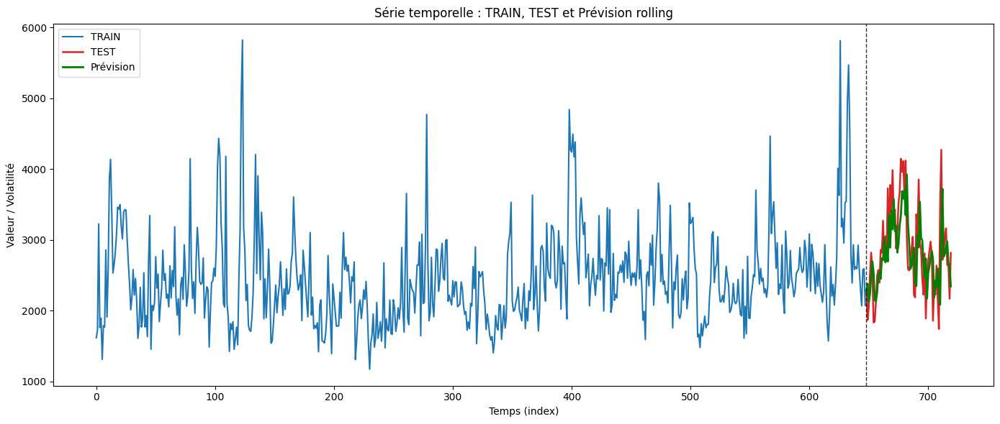

In [98]:
split_pos = len(y_train) - 0.5  # position de la coupure train/test

plt.figure(figsize=(14,6))


# Train en bleu
plt.plot(range(len(y_train)), y_train.values, color="tab:blue", linewidth=1.5, label="TRAIN")

# Test en rouge
plt.plot(range(len(y_train), len(ts_series)), y_test.values, color="tab:red", linewidth=1.8, label="TEST")

# Prévisions rolling (exemple avec écart-type conditionnel)
plt.plot(range(len(y_train), len(ts_series)), np.sqrt(rolling_sigma2),
         color="green", linewidth=2, label="Prévision")

# Ligne de séparation
plt.axvline(split_pos, linestyle="--", linewidth=1, color="black", alpha=0.8)

plt.title("Série temporelle : TRAIN, TEST et Prévision rolling")
plt.xlabel("Temps (index)")
plt.ylabel("Valeur / Volatilité")
plt.legend(loc="upper left")
plt.tight_layout()
plt.show()

In [99]:
import numpy as np
import pandas as pd

n_boot = 200   # nombre de répétitions bootstrap
predictions = []
test_size = len(y_test)

for b in range(n_boot):
    boot_sigma2 = []
    for i in range(test_size):
        train_i = ts_series.iloc[:len(y_train)+i]
        model = arch_model(train_i, mean="Zero", vol="GARCH", p=3, q=2)
        res = model.fit(disp="off")

        # Tirage bootstrap (paramètres perturbés)
        params = res.params + res.std_err * np.random.randn(len(res.params))
        model_boot = arch_model(train_i, mean="Zero", vol="GARCH", p=3, q=2)
        res_boot = model_boot.fit(starting_values=params, disp="off")

        fcast = res_boot.forecast(horizon=1, reindex=False)
        boot_sigma2.append(fcast.variance.values[-1, 0])
    predictions.append(boot_sigma2)

# Transformer en DataFrame
predictions = pd.DataFrame(predictions).T
sigma2_pred = predictions.median(axis=1)
ic_low = predictions.quantile(0.05, axis=1)
ic_high = predictions.quantile(0.95, axis=1)

sigma2_pred.index = y_test.index
ic_low.index = y_test.index
ic_high.index = y_test.index

d:\Portofolio Data science\Time Series\Travaux pratiques Bases\.venv\Lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 4.133e+05. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 0.1 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
d:\Portofolio Data science\Time Series\Travaux pratiques Bases\.venv\Lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 4.133e+05. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 0.1 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  war


Ljung-Box résidus (p-values):
 10    0.887002
20    0.906059
30    0.613271
Name: lb_pvalue, dtype: float64

Ljung-Box résidus^2 (p-values):
 10    0.962861
20    0.846992
30    0.574237
Name: lb_pvalue, dtype: float64

ARCH LM (p-val): 0.9912724851208412

Normalité — Jarque-Bera p=3.992e-32, Anderson-Darling p=9.155e-13


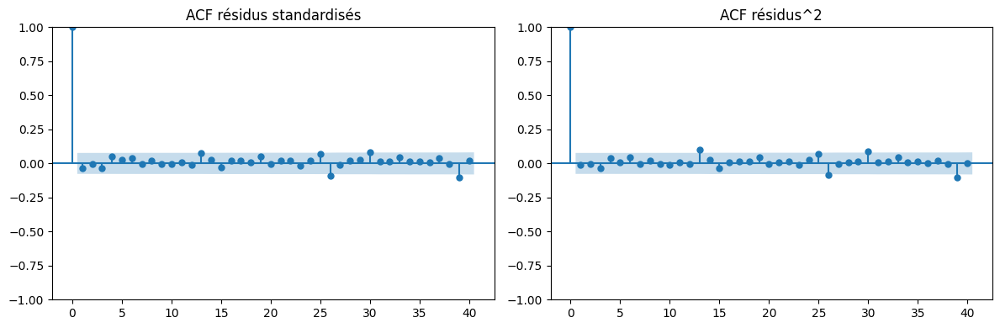

In [107]:
import numpy as np
import pandas as pd
from statsmodels.stats.diagnostic import acorr_ljungbox, het_arch, normal_ad
from statsmodels.stats.stattools import jarque_bera
from statsmodels.graphics.tsaplots import plot_acf
import matplotlib.pyplot as plt

# Résidus standardisés du fit sur TRAIN
std_resid = best_res.std_resid.dropna()

# ---- Tests Ljung-Box (quelques lags) ----
lags = [10, 20, 30]
lb_resid = acorr_ljungbox(std_resid, lags=lags, return_df=True)
lb_sq    = acorr_ljungbox(std_resid**2, lags=lags, return_df=True)

# ---- ARCH LM test (sur les résidus standardisés) ----
arch_lm = het_arch(std_resid, nlags=10)  # (stat, pval, fstat, fpval)

# ---- Normalité ----
jb_stat, jb_p, _, _ = jarque_bera(std_resid)
ad_stat, ad_p = normal_ad(std_resid)

print("\nLjung-Box résidus (p-values):\n", lb_resid["lb_pvalue"])
print("\nLjung-Box résidus^2 (p-values):\n", lb_sq["lb_pvalue"])
print("\nARCH LM (p-val):", arch_lm[1])
print(f"\nNormalité — Jarque-Bera p={jb_p:.4g}, Anderson-Darling p={ad_p:.4g}")

# ---- ACF visuelles ----
fig, ax = plt.subplots(1,2, figsize=(12,4))
plot_acf(std_resid, lags=40, ax=ax[0])
ax[0].set_title("ACF résidus standardisés")
plot_acf((std_resid**2), lags=40, ax=ax[1])
ax[1].set_title("ACF résidus^2")
plt.tight_layout()
plt.show()